<a href="https://colab.research.google.com/github/adeepH/CSOE18/blob/main/CSOE18_Image_Processing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [44]:
import numpy as np
from PIL import Image
from IPython.display import display 
from google.colab.patches import cv2_imshow
import cv2
import matplotlib.pyplot as plt

***1. Write a program to implement histogram equalization for the given image.***

In [31]:
img_filename = '/content/pexels-lena-glukhova-10569587.jpg'  
img = Image.open(img_filename)
 
def histogram_equalizer(image): 

    
    imgray = img.convert(mode='L')

    #convert to NumPy array
    img_array = np.asarray(imgray)

    """
    STEP 1: Normalized cumulative histogram
    """
    #flatten image array and calculate histogram via binning
    histogram_array = np.bincount(img_array.flatten(), minlength=256)

    #normalize
    num_pixels = np.sum(histogram_array)
    histogram_array = histogram_array/num_pixels

    #normalized cumulative histogram
    chistogram_array = np.cumsum(histogram_array)


    """
    STEP 2: Pixel mapping lookup table
    """
    transform_map = np.floor(255 * chistogram_array).astype(np.uint8)


    """
    STEP 3: Transformation
    """
    # flatten image array into 1D list
    img_list = list(img_array.flatten())

    # transform pixel values to equalize
    eq_img_list = [transform_map[p] for p in img_list]

    # reshape and write back into img_array
    eq_img_array = np.reshape(np.asarray(eq_img_list), img_array.shape)
 
    eq_img = Image.fromarray(eq_img_array, mode='L')

    return eq_img

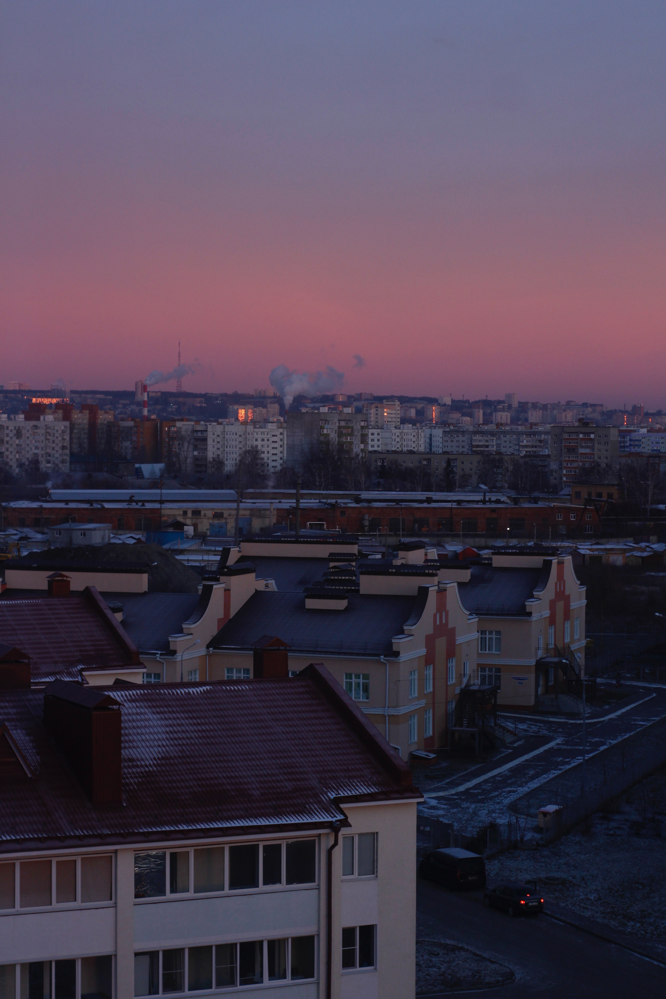

In [32]:
img

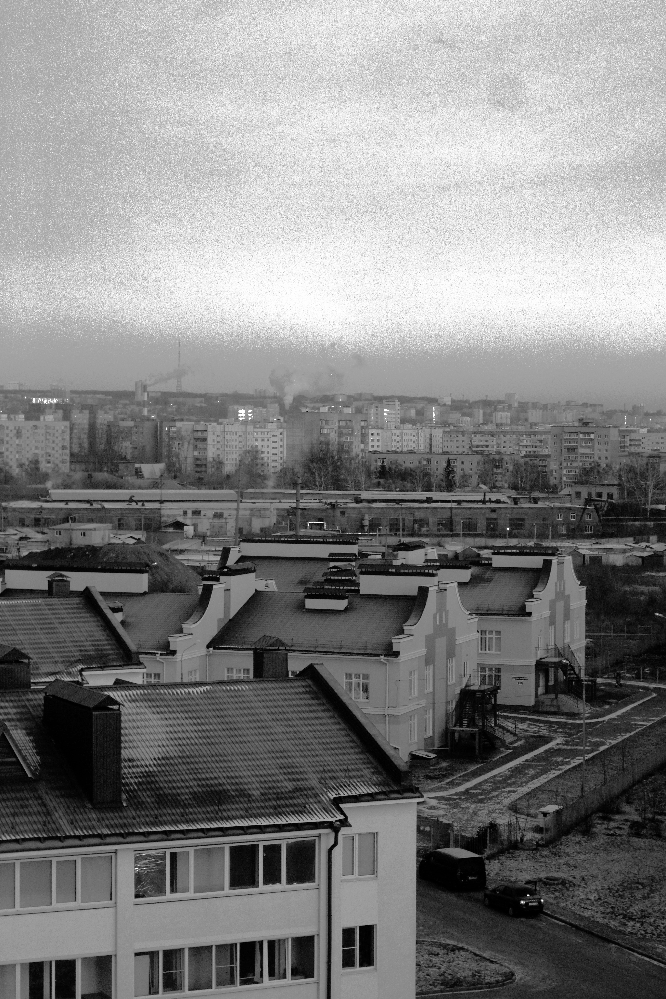

In [33]:
eq_img = histogram_equalizer(img)
eq_img 

***2. Write a program to implement Discrete Fourier Transformation for the given image and
apply ideal LPF and ideal HPF.***

***3. Write a program to segment the image using K-Means clustering.***

In [29]:
def k_means_segmentation(image,k):

    
    # Reshaping the image into a 2D array of pixels and 3 color values (RGB)
    pixel_vals = image.reshape((-1,3))
    
    # Convert to float type
    pixel_vals = np.float32(pixel_vals)

    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.85)
    
    # then perform k-means clustering wit h number of clusters defined as 3
    #also random centres are initially choosed for k-means clustering
     
    retval, labels, centers = cv2.kmeans(pixel_vals, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
    
    # convert data into 8-bit values
    centers = np.uint8(centers)
    segmented_data = centers[labels.flatten()]
    
    # reshape data into the original image dimensions
    segmented_image = segmented_data.reshape((image.shape))

    return segmented_image

In [41]:
image = cv2.imread('/content/pexels-lena-glukhova-10569587.jpg')
 
# Change color to RGB (from BGR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

seg_img = k_means_segmentation(image,6)

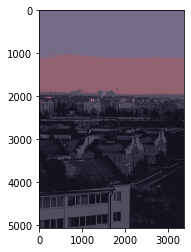

In [45]:
plt.imshow(seg_img)

***4. Write a program to implement K- Nearest Neighbor classifier.***